# Assignment #4 - Reinforcement Learning

### <font color="red"> DUE: Apr 16 (Tuesday) 11:00 pm </font>  

<font color="blue"> Sai Supreeth Segu </font>

# I. Overview

Describe the objective of this assignment. You can briefly state how you accompilsh it.

- In this assignment, I will learn about Reinforcement Learning and different ways of implementing it.
- But in this assigment we will learn about two methods namely:
    * Q - learning
    * SARSA
- I will learn about different terminology in RL like State, Action, Reward, Observation, policy and Q-Value.
- I will learn about parameter tuning and how to find the optimal parameter.
- I will learn about the environment of the Blackjack game and how it is implemented.
- The goal of oue problem is to win the game given a particular state.

# II. Problems 



## Blackjack

<img src="https://upload.wikimedia.org/wikipedia/commons/a/a2/Blackjack_game_1.JPG" width=800 />

Now, we play Blackjack! 
We have improved version of it from OpenAI Gym [Blackjack-V0](https://gym.openai.com/envs/Blackjack-v0/). Our blackjack has an additional betting option. Here follows the rule description. 


### <font color="red"> Game Introduction and Rules: </font>


Blackjack is a card game where the goal is to obtain cards that sum to as
near as possible to 21 without going over.  They're playing against a fixed
dealer.

Face cards (Jack, Queen, King) have point value 10.
Aces can either count as 11 or 1, and it's called 'usable' at 11.
This game is placed with an infinite deck (or with replacement).

The game starts with each player getting two face up cards and dealer
having one face up and face down card and the player needs to bet an 
amount of money within range of 1 to max bet (10). 
Note: Face up means that you will know what the card is.

The player can request additional cards (hit=1) until they decide to stop
(stick=0) or exceed 21 (bust).

After the player sticks, the dealer reveals their facedown card, and draws
until their sum is 17 or greater (fixed policy).  If the dealer goes bust the player wins.
You won't see the dealer's facedown card, just you will know if you have or lost
and you will get appropriate reward of +1 if you win, -1 if you loose or 0 if the match
is drawn.
(It is freedom of choice for you to change the reward function. If you want to change, you should explain the reason of the change.)

If the player wins, the amount he has bet will be doubled and given back. 
If the player and dealer have the same sum, then its a draw and the player will get
back the money he has bet. 
If the player loses then, the money he bet will be lost. 
If neither player nor dealer busts, the outcome (win, lose, draw) is
decided by whose sum is closer to 21. You are free to change the reward function to make it 
learn more efficiently. (i.e.,  the amount of money the user is winning after each round). 

Regardless of the number of players on the table, each player will be just playing against the 
dealer independently of the other players.

## BlackJack Environment

In [5]:
import collections
import numpy as np
import matplotlib.pyplot as plt
import gym
from gym import spaces
from gym.utils import seeding
%matplotlib inline

### Player class definition

Player class defines an object for each BlackJack player with a given *unique* name. It has three attributes, the player's name, current cards in hand, and total balance left to play games.  <code>get_info()</code> is getter method that prints out all three attributes.

In [6]:
class Player():
    """
        
        Player class to create a player object.
        eg: player = Player("player1", start_balance = 10)
        Above declaration will be for your agent.
        All the player names should be unique or else you will get error.
        
    """
    def __init__(self, player_name, start_balance = 10):
        self.player_name = player_name
        self.card = []
        self.starter_balance = start_balance
        self.total_balance = start_balance

    def recharge_account(self):
        self.total_balance = self.starter_balance
        
    def get_info(self):
        print("Player name: {}".format(self.player_name))
        print("Player card: {}".format(self.card))
        print("Player total_balance: {}".format(self.total_balance))     

Following functions are utilities and definition of card deck to play games and to check the game status. 

In [7]:
# 1 = Ace, 2-10 = Number cards, Jack/Queen/King = 10
deck = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 10, 10, 10]

def cmp(a, b):
    return float(a > b) - float(a < b)

def draw_card(np_random):
    return int(np_random.choice(deck))

def draw_hand(np_random):
    return [draw_card(np_random), draw_card(np_random)]


def usable_ace(hand):  # Does this hand have a usable ace?
    return 1 in hand and sum(hand) + 10 <= 21


def sum_hand(hand):  # Return current hand total
    if usable_ace(hand):
        return sum(hand) + 10
    return sum(hand)


def is_bust(hand):  # Is this hand a bust?
    return sum_hand(hand) > 21


def score(hand):  # What is the score of this hand (0 if bust)
    return 0 if is_bust(hand) else sum_hand(hand)


def is_natural(hand):  # Is this hand a natural blackjack?
    return sorted(hand) == [1, 10]

### Game Environment

The Blackjack game environment is defined as follows. Inheriting, OpenAI.Gym.Env, it overrides the interfances to enable the interfaction with the same interfaces with other OpenAI Gym environments. 

These are important member functions to be used by you:
1. add_player: You can add your player object with some initial amount of money

2. step: you need to send the action using this function, actions are hit(1) or stand(0)
        returns {'state': player info and dealer info (_get_obs), 
                 'reward': real-valued reward, 
                 'is_round_done': True/Fasle}
3. _get_obs: returns the state of the env or required information you can use to build your agent. 
             eg: {'player_info':{'player_sum_card': sum of cards, 
                                 'player_card': list of cards, 
                                 'player_total_balance': real-valued number, 
                                 'usable_ace' : True/False}, 
                 'dealer_info': dealer's first card}
4. init_round: will start a new round in the same game.
        returns {'state': player info and dealer info (_get_obs)}
          
5. reset: will reset the whole game and you will being again with the initial balance you had started the player object.
        returns nothing, will just reset the entire game.
          
6. bet_money: you can bet the amount using this method, takes in the money between (1, max_bet_cap). max_bet_cap is 10. 
        returns nothing.


In [8]:


class BlackjackEnv(gym.Env):
    """
    Simple blackjack environment
    
    Blackjack is a card game where the goal is to obtain cards that sum to as
    near as possible to 21 without going over.  They're playing against a fixed
    dealer.
    Face cards (Jack, Queen, King) have point value 10.
    Aces can either count as 11 or 1, and it's called 'usable' at 11.
    This game is placed with an infinite deck (or with replacement).
    The game starts with each (player and dealer) having one face up and one
    face down card.
    The player can request additional cards (hit=1) until they decide to stop
    (stick=0) or exceed 21 (bust).
    After the player sticks, the dealer reveals their facedown card, and draws
    until their sum is 17 or greater.  If the dealer goes bust the player wins.
    If neither player nor dealer busts, the outcome (win, lose, draw) is
    decided by whose sum is closer to 21.  The reward for winning is +1,
    drawing is 0, and losing is -1.
    The observation is: the players current sum, players current card, players balance left, 
    the dealer's one showing card (1-10 where 1 is ace),
    and whether or not the player holds a usable ace (0 or 1).
    
    Parameters
    ==========
    natural      boolean
                 option for 50% more reward on natural blackjack 
    
    """
    
    def __init__(self, natural=False):
        self.action_space = spaces.Discrete(2)
        self.observation_space = spaces.Tuple((
            spaces.Discrete(32),
            spaces.Discrete(11),
            spaces.Discrete(2)))
        self.seed()
        self.total_players = 1
        self.players = {}
        self.natural = natural
        self.dealer = []
        self.round_bet_info = {}
        self.max_bet_cap = 10

    def add_player(self, player_class):
        if player_class not in self.players and len(self.players) < self.total_players:
            self.players[player_class.player_name] = player_class
        else:
            raise Exception("Maximum number of player allowed: {}. You can increase the player count while initializing the environment".format(len(self.players)))

    def seed(self, seed=None):
        self.np_random, seed = seeding.np_random(seed)
        return [seed]

    def step(self, player_name, action):
        assert self.action_space.contains(action)
        if action:  # hit: add a card to players hand and return
            self.players[player_name].card.append(draw_card(self.np_random))
            if is_bust(self.players[player_name].card):
                done = True
                reward = -1
            else:
                done = False
                reward = 0
        else:  # stick: play out the dealers hand, and score
            done = True
            while sum_hand(self.dealer) < 17:
                self.dealer.append(draw_card(self.np_random))
            reward = cmp(score(self.players[player_name].card), score(self.dealer))
            if self.natural and is_natural(self.players[player_name].card) and reward == 1:
                reward = 1.5
        if done:
            self.settle_balance(int(reward), player_name)
        return {'state':self._get_obs(player_name), 'reward': reward, 'is_round_done': done}

    def _get_obs(self, player_name):
        return {'player_info':self.get_player_obs(player_name), 
                'dealer_info': self.dealer[0]}

    def get_player_obs(self, player_name):
        return {'player_sum_card':sum_hand(self.players[player_name].card), 
                'player_card':self.players[player_name].card, 
                'player_total_balance':self.players[player_name].total_balance, 
                'usable_ace' : usable_ace(self.players[player_name].card)}
    
    def get_valid_bet_amount(self, player_name):
        #print("player name: {} money left: {}".format(player_name, self.players[player_name].total_balance))
        if self.players[player_name].total_balance < 1:
            return {'is_round_done': True, 'valid_bet_amount': -1}
        max_bet_upper_limit = self.players[player_name].total_balance
        if self.players[player_name].total_balance >= self.max_bet_cap:
            max_bet_upper_limit = self.max_bet_cap            
        return {'is_round_done': False, 'valid_bet_amount': list(range(1, max_bet_upper_limit+1))}
            
    def init_round(self, player_name):         
        self.dealer = draw_hand(self.np_random)
        self.players[player_name].card = draw_hand(self.np_random)
        return {'state': self._get_obs(player_name)}        

    def bet_money(self, player_name, bet_amount):
        self.players[player_name].total_balance -= bet_amount
        self.round_bet_info[player_name] = bet_amount
            
    def settle_balance(self, is_winner, player_name):
        if is_winner == 1:
            #print("player winner")
            self.players[player_name].total_balance += (2 * self.round_bet_info[player_name])
        elif is_winner == 0:
            #print("Draw match")
            self.players[player_name].total_balance += self.round_bet_info[player_name]
        else:
            #print("player loser, wont get back the money, try next round")
            pass
    
    def reset(self, natural=False):
        for player_name, player_class in self.players.items():
            player_class.recharge_account()
        self.natural = natural
        self.dealer = []
        self.round_bet_info = {}


### Example Run with Random Players

This following code shows how to create an environment and players to play 10 games with 20 maximum rounds. This only includes random betting and random hit/stick decision making. 

In [38]:
env = BlackjackEnv()
player1 = Player('player1')
env.add_player(player1)
#Number of games
number_of_games = 10

#Number of rounds
number_of_rounds = 20

for _game in range(number_of_games):

    env.reset()
    print("-"* 50)
    print("Game Number: {}".format(_game + 1))
    print("-"* 50)
    for _round in range(number_of_rounds): 
        print("%"* 50)
        print("Game Number: {} Round Number: {}".format(_game+1, _round+1))
        print("%"* 50)
        
        #Check if you have enough money left in the account to bet, if not break and start a new game
        valid_bet_flag = env.get_valid_bet_amount(player1.player_name)
        if valid_bet_flag['is_round_done']:
            print("You are out of money ! Will go to next game !!")
            break
        bet_amount = valid_bet_flag['valid_bet_amount']
        
        #Get the observations i.e state and use it to decide how much you want to bet
        round_obs = env.init_round(player1.player_name)
        print("Initial state: {}".format(round_obs))  
        
        # If you have just $1 left in the bank, you have no choice but to bet that amount 
        # and hopefully leave it to the fate for your agent to win and continue playing or just
        # start a new game
        if len(bet_amount) == 1 and bet_amount[0] == 1:
            print("You can only bet 1. So betting only 1.")
            random_bet = 1
        else:
            random_bet = np.random.choice(bet_amount)
        print("Random Init Bet: {}".format(random_bet))
        env.bet_money(player1.player_name, random_bet)
          
        
        # Look at the state and take actions, here the actions are selected randomly
        # you can use the agent to select the action
        random_action = np.random.randint(0, 2)
        print("Action taken: {}".format(random_action))

        #Use the selected action to actually take the action in env by calling step
        round_obs = env.step(player1.player_name, random_action)
        print("State after 1st action: {}".format(round_obs))

        #Check if the game is not over, if your action is stand then the game is over, else
        #the game continues in this loop until your action is stand
        while not round_obs['is_round_done']:
            #Select an random action and take the action
            random_action = np.random.randint(0, 2)
            print("Action taken: {}".format(random_action))
            round_obs = env.step(player1.player_name, random_action)
            print("State after nth action: {}".format(round_obs))

        #Round over, but the game will continue untill you have exhausted your initial money 
        print("Balance Left: {}".format(round_obs['state']['player_info']['player_total_balance']))
        print("Round over")
        print("-%-"*30)
        if (_round + 1) == (number_of_rounds):
            print("Max number of rounds played. If you see this message, you are the winner.")

--------------------------------------------------
Game Number: 1
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
Random Init Bet: 6
Action taken: 0
player winner
State after 1st action: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 16, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
Balance Left: 16
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 16
Initial st

# III. Methods

- Decide your TD learning approach: SARSA or Q-learning? 
- Decide your function approximator.
- Describe your approach and the reason why you select it.
- Finish epsilon_greedy function and other TODOs. Explain it.
- Explain your codes.

### Temporal Difference Learning (1) (Review of the SARSA and Q-Learning)
- "Temporal difference (TD) learning refers to a class of model-free reinforcement learning methods which learn by bootstrapping from the current estimate of the value function." -Wikipedia Defination.
- TD learning is model free learning.
*Temporal difference (TD) learning* considers that the agent knows only the partial information of the MDP. 
With only current and next state transition and without any model transition probability, TD lets the agent explore the environment to examine the random policy. 
With an estiate of the value function $V(s)$, $\hat{V}(s)$, 

   $$ 
        \begin{align}
        V(s_t) &= R_{t+1} + \gamma V(s_{t+1}) \\
        V(s_t) &\sim R_{t+1} + \gamma \hat{V}(s_{t+1}) \\
        \Rightarrow \quad \delta_t &= R_{t+1} + \gamma \hat{V}(s_{t+1}) - V(s_t).
        \end{align}
    $$
    
- Here, $\delta$ represents the *temporal diffrence error*. 
- We can use this error as a gradient to update the value estimation.

$$
    \begin{align}
        V(s_t) &\leftarrow R_{t+1} + \alpha \delta_t \\
        V(s_t) &\leftarrow R_{t+1} + \alpha (R_{t+1} + \gamma \hat{V}(s_{t+1}) - V(s_t))
    \end{align}
$$

- There are two types of TD learning.

#### 1) SARSA (state-action-reward-state-action):
- For control problems, we have defined Q function above to evaluate the state and action altogether. 
- Updating the Q values with TD learning is similar to previous update with two different considerations. 
- First, we update the Q with assumption that we follow a certain behavior policy. Thus, we call this as on-policy control, or SARSA.

$$
    Q(s_t, a_t) \leftarrow Q(s_t, a_t) + \alpha ( R_{t+1} + \gamma Q(s_{t+1}, a_{t+1}) - Q(s_t, a_t)) 
$$

#### 2) Q-Learning:
- The goal of Q-Learning is to learn a policy, which tells an agent what action to take under what circumstances - Wikipedia Definition
- Without making assumption of behavior policy, we can explore other possible policies to update the Q. We call this as *off-policy control*, or **Q-learning**. 

$$
    Q(s_t, a_t) \leftarrow Q(s_t, a_t) + \alpha ( R_{t+1} + \gamma \max_a Q(s_{t+1}, a) - Q(s_t, a_t)) 
$$

- Both q-learning and sarsa will converge to a optimal policy.


**[Algorithm: SARSA]**
![](http://incompleteideas.net/book/ebook/pseudotmp8.png)


**[Algorithm: Q-learning]**
![](http://incompleteideas.net/book/ebook/pseudotmp9.png)

### (2) Choice of TD learning and Reason
- Q-learning and SARSA both methods will learn optimal policy.
- In Q-learning, we don't have policy and we can start with random values and can explore the states based on the results we will take and update the Q- values. If we find some better approach for updating the Q values we can follow that.
- But in SARSA, we will have a certain policy from start and we will explore all the states and actions and update the Q-value based on our policy.
- But there is high possibility that in the starting we don't know exactly what policy works.
- This will explore the each state and action and will update thre Q-value.
- So, this takes more time for converging as well.
- So, I have choosen Q-learning for implementing the algorithm.
- But, In Q-learing we won't explore the environment when compared to SARSA.
- That's the reason, I am using epsilon_greedy function, so that we can give some random actions when the probability is less 
- **Reasons :**
    - Faster Convergence
    - Off policy learning

### (3)Choice of Function Approximation and Reason

- I have taken Function Approximation as 34 states, 2 actions
- I have 2 actions sttaing one for hit and the another for stop
- I have taken 34 states because as the sum of cards at the intial stage can be 2.
- If there a situation such that when the sum is 21 and we got Ace there is a possibility of considering it as 11. - So, the total sum is 21+11 = 32. So, to reduce the chance of out of bound exception during training, I have taken 34.
- But the highest value will be 32 and the lowest value will be 2 and 1 if we are considering for dealer also as it has only one card in the beginning.

### (4) Implementation of selected approch

## RLAgent for Blackjack

Referencing the RLAgent in the lecture note, make your own agent class for the game. 

In [44]:
class BlackjackAgent():
    
#     blev = BlackjackEnv(natural=False)
#     p1 = Player(player_name='C1')
#     blev.add_player(p1)
    def reset_env(self):
        #print('here')
        pkev = BlackjackEnv(natural=False)
        p1 = Player(player_name='C1')
        p2 = Player(player_name='P1')
        self.p1 = p1
        pkev.add_player(p1)
        #print(p1)
        return pkev
    
    def __init__(self):
        self.env = self.reset_env()
        self.Q = np.zeros((34,2))
        
    def epsilon_greed(self, epsilon, s):
        #ac = [self.env.get_valid_actions(self.me)]
        ac = [0,1]
        if np.random.rand()<epsilon:
            return np.random.randint(len(ac))
        else:
            #print("agd : ",s)
            #print("fld:",s['player_sum_card'])
            #print("agd : ",ac)
            return np.argmax(self.Q[s['player_sum_card']][ac])
    
    def train(self,**params):
        
        # parameters
        gamma = params.pop('gamma', 0.99)
        alpha = params.pop('alpha', 0.1)
        epsilon = params.pop('epsilon', 0.1)
        maxiter = params.pop('maxiter', 1000) 
        sarsa = params.pop('sarsa',False)
        edecay = params.pop('edecay',None)
        import time
        rtrace = []
        for i in range(maxiter):
            if i == 20000:
                #print(self.Q)
                time.sleep(5)
            self.env = self.reset_env()
            if edecay is not None:
                epsilon = max(0.1,epsilon*edecay)
            #print('*'*50,i+1,'*'*50)
            #Check if you have enough money left in the account to bet, if not break and start a new game
            valid_bet_flag = self.env.get_valid_bet_amount(self.p1.player_name)
            if valid_bet_flag['is_round_done']:
                #print("You are out of money ! Will go to next game !!")
                break
            bet_amount = valid_bet_flag['valid_bet_amount']
        
            #Get the observations i.e state and use it to decide how much you want to bet
            round_obs = self.env.init_round(self.p1.player_name)
            #print("Initial state: {}".format(round_obs))  
        
            # If you have just $1 left in the bank, you have no choice but to bet that amount 
            # and hopefully leave it to the fate for your agent to win and continue playing or just
            # start a new game
            if len(bet_amount) == 1 and bet_amount[0] == 1:
                #print("You can only bet 1. So betting only 1.")
                random_bet = 1
            else:
                random_bet = np.random.choice(bet_amount)
                #print("Random Init Bet: {}".format(random_bet))
            self.env.bet_money(self.p1.player_name, random_bet)
        
            random_action = np.random.randint(0, 2)
            #print("Action taken: {}".format(random_action))
            
            #Use the selected action to actually take the action in env by calling step
            res = self.env.step(self.p1.player_name, random_action)
            #print("State after 1st action: {}".format(round_obs))
            rewards = []
            #res = {'is_round_done':False}
            while not res['is_round_done']:
                #print('-'*50)
                #print(self.env.get_current_state())
                f = 0
                s = self.env.get_player_obs(self.p1.player_name)
                a = self.epsilon_greed(epsilon,s)
                #va = [self.env.get_valid_actions(self.me)]
                va = [0,1]
                res = self.env.step(self.p1.player_name, a)
                #res = self.env.player_play(self.me,va[a])
                #end = res[-1]
                r = res['reward']
                rewards.append(r)
                #print("1:",rewards)
                if not res['is_round_done']:
                    f = 1
                    s1 = self.env.get_player_obs(self.p1.player_name)
                    a1 = self.epsilon_greed(epsilon,s1)
                    #va1 = self.env.get_valid_actions(self.me)
                    res = self.env.step(self.p1.player_name, a1)
                    r1 = res['reward']
                    rewards.append(r1)
                    #print("2:",rewards)
                s2 = self.env.get_player_obs(self.p1.player_name)
                #print("S => ",s)
                #print("S2 => ",s2)
#                 print("s -> " ,s)
#                 print("s1 -> ",s1)
                    # if f:
                    # self.Q[s1,a1]
                #print("va=> ",va)
                #print("a=> ",a)
                self.Q[s['player_sum_card']][a] += alpha*(r + gamma*np.max(self.Q[s2['player_sum_card']][va]) - 
                                      self.Q[s['player_sum_card']][a])  
                
            self.env = self.reset_env()
            rtrace.append(np.sum(rewards))
            #print(rtrace)
        return rtrace,self.Q
    
    def choose(self, s):
        return np.argmax(self.Q[s['player_sum_card']][0,1])
    
    def play(self):
        self.env = self.reset_env()
        self.env.init_round(self.p1.player_name)
        f = 0
        #res['is_round_done'] = False
        while not f:
            print('-'*79)
            print(self.env.get_player_obs(self.p1.player_name))
            
            s = self.env.get_player_obs(self.p1.player_name)
            valid_ac = [0,1]
            #valid_ac = self.env.get_valid_actions(self.me)
            a = np.argmax(self.Q[s['player_sum_card']][valid_ac])
            
            res = self.env.step(self.p1.player_name, a)
            f= res['is_round_done']
            
            if not f:
                s = self.env.get_player_obs(self.p1.player_name)
                #valid_ac = self.env.get_valid_actions(self.me)
                a = np.argmax(self.Q[s['player_sum_card']][valid_ac])
                res = self.env.step(self.p1.player_name, a)
                f= res['is_round_done']
            print(res)
            print(self.env.get_player_obs(self.p1.player_name))


In [45]:
proplayer1 = BlackjackAgent()

In [146]:
proplayer1.train(maxiter = 120,edecay=0.99,epsilon=0.2,gamma=0.8)

here
************************************************** 1 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [2, 8], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
Random Init Bet: 6
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [2, 8, 9], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
--------------------------------------------------
agd :  {'player_sum_card': 19, 'player_card': [2, 8, 9], 'player_total_balance': 4, 'usable_ace': False}
fld: 19
agd :  [0, 1]
player winner
S =>  {'player_sum_card': 19, 'player_card': [2, 8, 9], 'player_total_balance': 4, 'usable_ace': False}
S2 =>  {'player_sum_card': 19, 'player_card': [2, 8, 9], 'player_total_balance': 16, 'usable_ace': False}
a=>  0
here
here
************************************************** 2 ***************************

here
************************************************** 16 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
Random Init Bet: 4
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
here
here
************************************************** 17 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [10, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 2}}
Random Init Bet: 8
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'

************************************************** 30 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
Random Init Bet: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
here
here
************************************************** 31 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [1, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 2}}
Random Init Bet: 7
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_

************************************************** 45 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [9, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
Random Init Bet: 2
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [9, 4, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
here
here
************************************************** 46 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
Random Init Bet: 6
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {

here
************************************************** 60 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [9, 8], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
Random Init Bet: 9
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [9, 8, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
here
here
************************************************** 61 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [6, 7], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 3}}
Random Init Bet: 10
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [6, 7, 2], 'p

************************************************** 73 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 6}}
Random Init Bet: 5
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10, 8], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 6}}
--------------------------------------------------
player loser, wont get back the money, try next round
S =>  {'player_sum_card': 19, 'player_card': [1, 10, 8, 10], 'player_total_balance': 5, 'usable_ace': False}
S2 =>  {'player_sum_card': 29, 'player_card': [1, 10, 8, 10], 'player_total_balance': 5, 'usable_ace': False}
a=>  1
here
here
************************************************** 74 **************************************************
player name: C1 money left: 10
Initial state: {'state': {

************************************************** 84 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 2}}
Random Init Bet: 1
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [6, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 2}}
here
here
************************************************** 85 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [9, 9], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
Random Init Bet: 2
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'playe

************************************************** 98 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
Random Init Bet: 2
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 16, 'player_card': [1, 5], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
here
here
************************************************** 99 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 10}}
Random Init Bet: 10
Action taken: 0
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_

************************************************** 110 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 8}}
Random Init Bet: 9
Action taken: 0
Draw match
State after 1st action: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [1, 10], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 8}}
here
here
************************************************** 111 **************************************************
player name: C1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
Random Init Bet: 8
Action taken: 1
State after 1st action: {'state': {'player_info': {'player_sum_card': 6, 'player_card': [3, 3, 10], 'player_total_balance': 10, 'usable_ace': False}, 'deale

In [46]:
proplayer1.train(maxiter = 250,edecay=0.99,epsilon=0.2,gamma=0.8)

([0.0,
  1.0,
  0.0,
  0.0,
  0.0,
  0.0,
  -1.0,
  0.0,
  1.0,
  -1,
  0.0,
  0.0,
  0.0,
  0.0,
  1.0,
  0.0,
  0.0,
  1.0,
  0.0,
  0.0,
  -1.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  -1.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  -1.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  -1.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  1.0,
  0.0,
  1.0,
  0.0,
  0.0,
  0.0,
  1.0,
  0.0,
  1.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  -1.0,
  -1.0,
  -1.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  -1.0,
  1.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  -1,
  0.0,
  0.0,
  -1,
  0.0,
  1.0,
  0.0,
  0.0,
  -1,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  1.0,
  0.0,
  0.0,
  0.0,
  1.0,
  0.0,
  0.0,
  -1,
  0.0,
  0.0,
  0.0,
  

In [27]:
proplayer1.train(maxiter = 250,edecay=0.99,epsilon=0.2,gamma=0.8)

array([[ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [-0.1       ,  0.        ],
       [ 0.        ,  0.        ],
       [-0.002     , -0.1       ],
       [-0.198     , -0.271     ],
       [-0.09404   , -0.23257975],
       [-0.198     , -0.19      ],
       [-0.10196   , -0.09608634],
       [-0.29404   , -0.33089464],
       [-0.29404   , -0.27714193],
       [-0.20172712, -0.22636749],
       [ 0.56525313,  0.        ],
       [ 1.23179029,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,

In [ ]:
import socket
import os
import subprocess
import ast
import numpy as np
#import BlackjackAgent
player = 'supreeth' #enter unique name for your game
s = socket.socket()
host = '10.216.27.119' # change ip addres to ip adress of your computer or use 'localhost' to practice
#host = 'localhost'
port = 9999

s.connect((host, port))

while True:
    data = s.recv(1024)
    if data.decode("utf-8") == 'send':
        s.send(str.encode( player))
        client_response = str(s.recv(20480), "utf-8")
        print(client_response, end="")
        break
while True:
    data = s.recv(1024)
    if data.decode("utf-8") == 'sendbet':
        ro=str(s.recv(20480), "utf-8")
        ro=ast.literal_eval(ro)
        print(ro)
# The above observation are stored in dict format. To access specific variables use syntax as 
# ro['state']['player_info']['player_total_balance']
# send whichever variable information stored in ro to your agent to help make the decision
#### Look at the above observations stored in variable ro as dictionary and store bet amount in variable bet#####
        bet=np.random.choice(10)
        s.send(str.encode( str(bet)))
        #a
    if data.decode("utf-8") == 'sendaction':
        ro=str(s.recv(20480), "utf-8")
        ro=ast.literal_eval(ro)
        print(ro)
        #follow same procedure as abov to send observations to your agent
        ###### Look at the above observations and action in variable action#####
        
        #action = np.random.randint(0, 2)
        #proplayer1 = BlackjackAgent()
        #Q = proplayer1.train(maxiter = 150,edecay=0.99,epsilon=0.2,gamma=0.8)
        psum=ro['state']['player_info']['player_sum_card']
        dsum=ro['state']['dealer_info']
        ace=ro['state']['player_info']['usable_ace']
        s=np.array([int(psum),int(dsum),int(ace)])
        action=proplayer1.choose(s)
        #action = np.argmax(proplayer1.Q[s['player_sum_card']][valid_ac])
        print("action ",action)
        s.send(str.encode( str(action)))
    if data.decode("utf-8") == 'gameover':
        print("Game over wait for others to play and wait for results")

Connection established, Names collected

In [33]:
proplayer1.play()

-------------------------------------------------------------------------------
{'player_sum_card': 15, 'player_card': [10, 5], 'player_total_balance': 10, 'usable_ace': False}
{'state': {'player_info': {'player_sum_card': 25, 'player_card': [10, 5, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 6}, 'reward': -1, 'is_round_done': True}
{'player_sum_card': 25, 'player_card': [10, 5, 10], 'player_total_balance': 10, 'usable_ace': False}


### (5) Explanation of the codes

- I have created this class for Blackjack agent.
- I have defined reset_env() for resetting the environment after each game.
- eplison_greed function() is used for returning the maximum value of a given state
- In train function, first I am assigning random action and then if round doesn't end and it will go into while loop and will select action having more value and then play the game(Step function).
- Then if the game doesn't end it will again follow the same process and then update the Q-value
- For testing the function, I have written play function where it plays with the dealer.
- It will select the action based on our Q-value matix generated in train.

# IV - Results

- Describe the choice of your parameters for $\gamma$, $\alpha$, and $\epsilon$. 
  - Run experiments to find good parameters
  - Show the experimental outputs to show the process of your selection
- Visualize the results and explain outputs (even from mine.)
  - Run the codes and tell me what you observe
  - Add more visualizations to enrich your explanation.

### Utility functions for Plotting

In [211]:
### Plotting tools 

def plot_trace(agent, start, trace, title="test trajectory"):
    plt.plot(trace[:, 0], trace[:, 1], "ko-")
#     plt.text(env.goal_pos[1], agent.size[0]-env.goal_pos[0]-1, 'G')
    plt.text(agent.env.goal_pos[1], agent.size[0]-agent.env.goal_pos[0]-1, 'G')
    plt.text(start[1], agent.size[0]-start[0]-1, 'S')
    plt.xlim([0, agent.size[1]])
    plt.ylim([0, agent.size[0]])
    

def plot_train(agent, rtrace):

    fig = plt.figure(figsize=(12,10))
    
    # Reward plot
    ax = fig.add_subplot(221)
    plt.xticks(np.linspace(0,len(rtrace),6).astype('int'),np.linspace(0,100,6).astype('int'))
    plt.plot(rtrace)
    plt.ylabel("sum of rewards")

#     # Total numbers of steps plot
#     ax1 = fig.add_subplot(222)
#     plt.xticks(np.linspace(0,len(steps),6).astype('int'),np.linspace(0,100,6).astype('int'))
#     plt.plot(steps)
#     plt.ylabel("# steps")
    
    # contour plot for agent.Q
    ax2 = fig.add_subplot(223)
    xs = range(agent.size[1])
    ys = range(agent.size[0])
    maxQ = np.max(agent.Q, axis=2)
    h_b = (maxQ==-np.inf)
    maxQ[h_b] = 0
    maxQ[h_b] = np.min(maxQ) - 100
    cs = plt.contourf(xs, ys[::-1], maxQ)
    plt.colorbar(cs)
#     plt.text(agent.env.goal_pos[1], agent.size[0]-agent.env.goal_pos[0]-1, 'G')
    #plt.text(agent.env.goal_pos[1]-1, agent.size[0]-agent.env.goal_pos[0]-1-1, 'G',color='red',size=18)
#     plt.text(start[1], agent.size[0]-start[0],'S')
    #plt.text(start[1]+1, agent.size[0]-start[0]-1, 'S',color='white',size=18)
    plt.ylabel("max agent.Q")

#     # plot traces
#     ax3 = fig.add_subplot(224)
#     plot_trace(agent, start, trace, "trace of the last episode")

    plt.plot()

In [ ]:
agent3 = BlackjackAgent()
#start = [8,0]
rtrace = agent3.train(maxiter = 10000,epsilon=0.2,gamma=0.9)
#plot_train(agent3, rtrace)

1: [1.0]
[1.0]
1: [0.0]
[1.0, 0.0]
1: [-1.0]
[1.0, 0.0, -1.0]
[1.0, 0.0, -1.0, 0.0]
1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0]
1: [-1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0]
1: [0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0]
1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0]
1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0]
1: [0.0]
[1.0, 

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0]
1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0]
1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [0]
2: [0, -1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0,

1: [-1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0,

1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [0]
2: [0, -1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [0]
2: [0, 0]
1: [0, 0, -1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0

1: [-1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [0]
2: [0, -1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [0]
2: [0, 0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [0]
2: [0, -1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [0]
2: [0, 0]
1: [0, 0, 0]
2: [0, 0, 0, 1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [0]
2: [0, -1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [0.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1.0]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

1: [-1]
[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0,

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

[1.0, 0.0, -1.0, 0.0, 1.0, -1, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, -1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1, -1.0, 0.0, 1.0, 1.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, -1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, -1, 0.0, -1, 0.0, 1.0, -1.0, -1, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, -1

## PLOT1
#### Params :
- gamma = 0.8
- alpha = 0.1
- **epsilon = 0.2**
- maxiter = 10000

In [194]:
agent1 = BlackjackAgent()
#start = [8,0]
_= agent1.train(maxiter = 10000,epsilon=0.2,alpha=0.1,gamma=0.8)
#plot_train(agent1, rtrace1, steps1, agent1.test(start), start)
agent1.Q

array([[ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.3881592 ,  0.        ],
       [-0.1       ,  0.06043063],
       [ 0.07518069,  0.41014893],
       [-0.1       ,  0.86189139],
       [ 0.23914945,  1.12532183],
       [-0.08355662,  1.7877422 ],
       [-0.30410507,  0.71812385],
       [-0.59752443,  0.32618506],
       [-0.46382941,  0.19060335],
       [-0.88162739,  0.08456259],
       [-0.51858287, -0.37097071],
       [-0.75056615, -0.64247191],
       [-0.21032157, -0.48211515],
       [ 1.19134329, -0.80256604],
       [ 3.37822071, -0.79305088],
       [ 4.27762374, -0.31578269],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,

## PLOT2
#### Params :
- gamma = 0.8
- alpha = 0.1
- **epsilon = 0.4**
- maxiter = 10000

In [195]:
agent1 = BlackjackAgent()
_= agent1.train(maxiter = 10000,epsilon=0.4,alpha=0.1,gamma=0.8)
agent1.Q

array([[ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [-0.1       ,  0.        ],
       [-0.27399566,  0.37713801],
       [ 0.08831602,  0.22591055],
       [-0.16261306,  0.34767193],
       [ 0.13791064,  0.54442293],
       [ 0.40794129,  0.9899233 ],
       [-0.15990219,  0.41112629],
       [ 0.04585317,  0.01506039],
       [-0.67959148, -0.25751705],
       [-0.70593811, -0.04683518],
       [-0.76358106,  0.58647601],
       [-0.68083826, -0.63163099],
       [-0.83647853, -0.83364286],
       [ 1.65707776, -0.56526173],
       [ 1.90954767, -0.82868348],
       [ 4.35950071, -0.63625587],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,

## PLOT3
#### Params :
- gamma = 0.8
- alpha = 0.1
- **epsilon = 0.9**
- maxiter = 10000

In [196]:
agent1 = BlackjackAgent()
_= agent1.train(maxiter = 10000,epsilon=0.9,alpha=0.1,gamma=0.8)
agent1.Q

array([[ 0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00],
       [-2.00000000e-03,  1.52619687e-02],
       [-1.92163636e-01, -2.70454459e-02],
       [-1.35534751e-01,  9.23433772e-03],
       [-3.23154267e-01,  2.35653887e-01],
       [-2.39819402e-01,  6.01030378e-01],
       [ 7.65413822e-01,  1.18327820e+00],
       [-5.79905664e-01, -1.44942466e-01],
       [-5.97682592e-01, -5.72764347e-02],
       [ 3.82350291e-02, -1.79756728e-01],
       [-8.76904784e-02, -2.06672328e-01],
       [-1.84172685e-01, -1.62404664e-01],
       [-5.99789070e-01, -2.83764608e-01],
       [-1.17405830e-01, -6.12040097e-01],
       [ 1.21809239e+00, -1.48054832e-01],
       [ 3.10569735e+00, -4.92971768e-01],
       [ 4.41058671e+00, -6.35613474e-01],
       [ 0.00000000e+00,  0.00000000e+00],
       [ 0.

## PLOT4
#### Params :
- **gamma = 0.9**
- alpha = 0.1
- epsilon = 0.2
- maxiter = 10000

In [197]:
agent1 = BlackjackAgent()
_= agent1.train(maxiter = 10000,epsilon=0.2,alpha=0.1,gamma=0.9)
agent1.Q

array([[ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [-0.1       ,  0.06705245],
       [-0.1       ,  0.30558586],
       [-0.15490493,  0.15773123],
       [-0.19643413,  1.11578688],
       [-0.02358893,  1.19444769],
       [-0.07705635,  3.55359223],
       [ 0.45479494,  1.40454224],
       [ 0.17044844,  0.75495474],
       [-0.15804642,  0.43191306],
       [-0.35780267,  1.09410696],
       [-0.1926307 ,  0.65043512],
       [-0.23142431,  0.58723041],
       [ 0.96548712, -0.5787905 ],
       [ 1.88110023,  0.01829398],
       [ 5.46595344,  0.603587  ],
       [ 8.69051009, -0.48812817],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,

## PLOT5
#### Params :
- **gamma = 0.2**
- alpha = 0.1
- epsilon = 0.2
- maxiter = 10000

In [198]:
agent1 = BlackjackAgent()
_= agent1.train(maxiter = 10000,epsilon=0.2,alpha=0.1,gamma=0.2)
agent1.Q

array([[ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [-0.1       , -0.01893196],
       [ 0.        ,  0.04179265],
       [-0.19004079,  0.00902769],
       [-0.06231194,  0.05037157],
       [-0.06291846,  0.00198353],
       [-0.1       ,  0.08992335],
       [-0.71663658, -0.23844942],
       [-0.64350577, -0.54760188],
       [-0.72161079, -0.34920366],
       [-0.61382461, -0.64599295],
       [-0.7967864 , -0.64481671],
       [-0.82645948, -0.80387832],
       [-0.68702569, -0.55521375],
       [ 0.67502627, -0.57244608],
       [ 0.66868729, -0.7486551 ],
       [ 1.18579129, -0.86910033],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,

## PLOT6
#### Params :
- **gamma = 0.99**
- alpha = 0.1
- epsilon = 0.2
- maxiter = 10000

In [199]:
agent1 = BlackjackAgent()
_= agent1.train(maxiter = 10000,epsilon=0.2,alpha=0.1,gamma=0.99)
agent1.Q

array([[ 0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00],
       [-1.00000000e-01,  0.00000000e+00],
       [-1.00000000e-04,  3.60805449e-01],
       [ 5.96510780e-01,  1.08061112e-02],
       [ 2.03940980e-01,  4.00986432e+00],
       [ 2.13646835e-01,  5.60607454e+00],
       [ 4.27750435e+00,  1.08198119e+01],
       [ 1.79451427e+00,  4.68404746e+00],
       [ 2.05955957e+00,  1.93596530e+00],
       [ 9.28734314e-01,  3.30994592e+00],
       [ 2.05197854e+00,  7.21687419e+00],
       [ 1.44037980e+00,  1.51963163e+00],
       [ 1.95979238e+00,  1.00537210e+00],
       [ 1.42696584e+00,  1.04048446e+00],
       [ 8.77322493e+00,  4.47644920e+00],
       [ 1.73830523e+01,  2.28704414e+00],
       [ 3.13993433e+01, -2.17729255e-01],
       [ 0.00000000e+00,  0.00000000e+00],
       [ 0.

### (1) Selected parameters. (Reports the selected parameters for both problems.)

- Optimal parameters
    - gamma = 0.9
    - epsilon = 0.2
    - alpha = 0.1
    - maxiter = 10000
    - edecay = 0.9995 (depends on your maxiter)

### (2) Reasoning Behind selecting parameters (Experimental outputs that show the choice of parameters. How do you choose them? ) :

- we are using Q-learning, so there are chances that exploration won't be enough.
- So, I have used decaying epsilon function.
- In starting of learning phase agent dont know about what policy to use so it need to explore the environment and as it playes more and more games it will get to know how each state and action will reward.
- So decaying epsilon function will allow us to explore the environment in start and exploit those exprerience as we go.
    $$
    epsilon = min(0.1,epsilone*decay_rate)
    $$
- initially epsilon will be 1 and decay_rate depends on your maxiter value.
- We can say from the experimental values that if epsilon value is more then Q-values are negative for most of the actions and if epsilon value is 0.4 then Q-values are al most same for both the actions.
- So, I have selected epsilon value as 0.2
- If the gamma value is less, then most of the values are negative and if the value is high then Q-values are more for action 0 even if the sum is 12,13 and 14
- So, I have selected gamma value as 0.9

### (3) Output plots 

### Reward Plot

In [ ]:
agent3 = BlackjackAgent()
#start = [8,0]
rtrace = agent3.train(maxiter = 10000,epsilon=0.2,gamma=0.9)
#plot_train(agent3, rtrace)

Text(0,0.5,'sum of rewards')

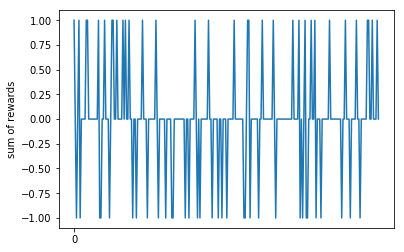

In [228]:
plt.xticks(np.linspace(0,len(rtrace),6).astype('int'),np.linspace(0,100,6).astype('int'))
plt.plot(rtrace[:250])
plt.ylabel("sum of rewards")

In [ ]:
agent4 = BlackjackAgent()
#start = [8,0]
rtrace = agent4.train(maxiter = 10000,epsilon=0.2,gamma=0.9)
#plot_train(agent3, rtrace)

1: [-1]
[-1]
1: [1.0]
[-1, 1.0]
1: [1.0]
[-1, 1.0, 1.0]
1: [-1.0]
[-1, 1.0, 1.0, -1.0]
1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0]
1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0]
1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0]
1: [0]
2: [0, 1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0]
1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0]
1: [0]
2: [0, -1]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1]
1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0]
1: [-1]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1]
1: [1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0]
1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0]
1: [0]
2: [0, 0]
1: [0, 0, -1]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1]
1: [0]
2: [0, 1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0]
1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0]
1: [0]
2: [0, -1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0]
1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0,

1: [0]
2: [0, 0.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0]
1: [-1]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0,

1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0]
1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0,

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0]
1: [-1]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 

1: [0.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0]
1: [0]
2: [0, -1]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1

1: [1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0]
1: [0]
2: [0, 1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1

1: [0]
2: [0, 1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0]
1: [0]
2: [0, -1]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, 

1: [0]
2: [0, 1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0

1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

1: [0]
2: [0, 1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

1: [0]
2: [0, 1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0

1: [0]
2: [0, 1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

1: [0]
2: [0, 0]
1: [0, 0, 1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, 

1: [0]
2: [0, -1]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0,

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

1: [1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

1: [0]
2: [0, 1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0

1: [-1]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0,

1: [0]
2: [0, 0]
1: [0, 0, -1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0,

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

1: [0]
2: [0, 1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0

1: [0]
2: [0, -1]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0,

1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.

1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.

1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.

1: [1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0

1: [1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

1: [1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

1: [1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

1: [-1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

1: [0]
2: [0, -1]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0,

1: [1.0]
[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

[-1, 1.0, 1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1.0, -1, -1.0, -1, 1.0, -1.0, -1, 1.0, -1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1.0, -1.0, 1.0, -1, 1.0, 0.0, 1.0, -1, -1.0, -1, -1.0, -1.0, 0.0, 1.0, 1.0, -1, -1, -1, 1.0, 1.0, 0.0, -1.0, 0.0, -1, -1.0, 1.0, 1.0, -1, -1.0, -1.0, 1.0, 0.0, -1.0, -1.0, -1.0, -1.0, -1.0, 1.0, -1, -1.0, 0.0, -1, 1.0, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, 1.0, 1.0, -1.0, 1.0, -1, 1.0, -1, -1.0, 1.0, 1.0, 1.0, 1.0, -1.0, 1.0, -1, -1.0, -1, 1.0, -1, -1.0, -1, -1.0, 0.0, -1.0, 0.0, -1, 1.0, -1.0, -1.0, 0.0, -1.0, -1, -1.0, -1.0, 1.0, -1.0, 0.0, -1.0, -1, 1.0, -1.0, -1.0, -1.0, 1.0, -1.0, 1.0, 1.0, -1, 1.0, 0.0, -1.0, -1, 1.0, 0.0, 1.0, -1, -1, -1, -1.0, -1, -1.0, -1, 1.0, 1.0, -1.0, -1.0, -1.0, -1, 1.0, 1.0, -1, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, -1, 1.0, -1, -1, -1, 1.0, -1, -1.0, 1.0, 1.0, -1.0, 0.0, 1.0, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1, -1.0, 1.0, -1, -1.0, -1, -1, -1, 1.0, 0.0, 1.0, 1.0, -1, -1.0, 1.0, -1, -1, 1.0, -1.0, 1.0, 1.0, 1.0, -1, -1.0, 1.0, 0.0, 1.0, 0.0, -1

### Q-Value Plot

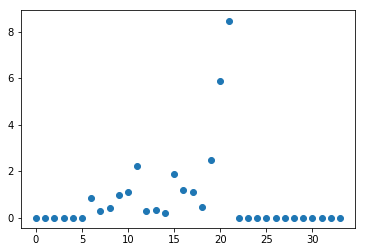

In [241]:
xs = range(agent3.Q.shape[0])
#ys = range(agent3.Q.shape[1])
maxQ = np.max(agent3.Q, axis=1)
# h_b = (maxQ==-np.inf)
# maxQ[h_b] = 0
# maxQ[h_b] = np.min(maxQ) - 100
# cs = plt.contourf(xs, ys, maxQ)
# plt.colorbar(cs)
plt.scatter(xs,maxQ)

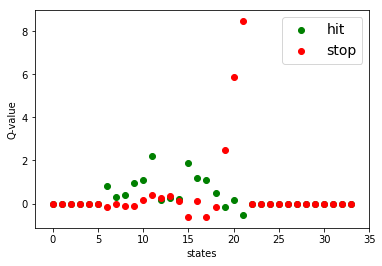

In [246]:
xs = range(agent3.Q.shape[0])
hit = []
stop = []
for i in range(agent3.Q.shape[0]):
    if agent3.Q[i][0] > agent3.Q[i][1]:
        stop.append(agent3.Q[i][0])
        hit.append(agent3.Q[i][1])
    else:
        hit.append(agent3.Q[i][1])
        stop.append(agent3.Q[i][0])
plt.scatter(xs,hit,c='G',label='hit')
plt.scatter(xs,stop,c='R',label='stop')
plt.xlabel('states')
plt.ylabel('Q-value')
plt.legend(prop={'size':14})

### (4) reading and analysis of learning results and plots

- From the above graphs of reward and Q-value we can conclude the following things
- For the values less than 5 and greater 22, The model haven't seen these values and so the values are not updated.
- The Q-value is maximum for the value 21 saying that it should stop at any cost
- The Q-values are more for values greater than 18 and less than 22 stating that it should stop now.
- All the other values of Q haven't exceeded by 2 means there are chances of losing and winning for these values.
- From the reward plot, we can say that there are equal chances of winning and losing even after training many rounds and games
- We have taken optimal values for plotting this graph and from Q-values we can say that model is working perrfectly given different states

# V. Conclusions

Discuss the challenges or somethat that you learned. 
If you have any suggestion about the assignment, you can write about it. 

- In this assignment, I have learned about reinforcement learning
- I have learnt how to implement reinforcement learning using two methods
    i)Sarsa
    ii) Q-learning
- I have learnt how to choose states and action given a situation.
- I have learnt about exploration, exploitation and discount factor
- The challenges I have faced are implementing exploration in Q-learning
- In the end I have implemented it using epsilon-decay function
- I have learnt about how to select valid action in a given situation.

# Extra Credit for Tournament Top16!

- In two classes, we will have qualification and tournament.
- In qualification game, individual will play against a dealer for one game for 50 round. 
  - Highly ranked (by the profit) and non-broke players will proceed to the tournament.
  - max. 32 players will be cut for main tournament.
- In tournament, 4 players will be play in each round.
  - In a table game, the game lasts until two players broke
  - In final, the game will ends in 50 rounds and winner will be the one with highest balance. 

## Grading

We will test your notebook with an additional grid.txt file. Please make sure to test in different maze input files. 

points | | description
--|--|:--
5 | Overview| states the objective and the appraoch 
35 | Methods | 
 |10| Review of the SARSA and Q-Learning
 | 5| Choice of TD learning and Reason
 | 5| Choice of Function Approximation and Reason
 |10| Implementation of the selected approach (RLAgent)
 | 5| explanation of the codes
45 | Results 
 |10| Reports the selected parameters 
 |15| Experimental outputs that show the choice of parameters. How do you choose them?
 |10| Output plots (5 for each)
 |10| reading and analysis of learning results and plots
10 | Participation to the tournament.
5 | Conclusions 
